In [1]:
# To support both python 2 and python 3
from __future__ import division, print_function, unicode_literals

# Common imports
import numpy as np
import os

# to make this notebook's output stable across runs
def reset_graph(seed=42):
    tf.reset_default_graph()
    tf.set_random_seed(seed)
    np.random.seed(seed)

# To plot pretty figures
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

In [2]:
import tensorflow as tf

## Basic RNN's

For each time step t, there is a vector of inputs x, pased in a recurrent nueron. As the per usualy FFNN, this neuron has an output y and y is also fed back

For the next time step t+1, there is another vector of inputs, again having output y, but the previous output from time t-1 for y is passed into it as well

Each recurrent nuerone has two sets of weights, on for the input $x_{(t)}$ and the other for outputs at prevopis time step $y_{(t-1)}$. Call these weight vectors $w_x$ and $w_y$. We can generlize and call these $W_x$ and $W_y$. The output of a recurrent neuron is

$
y_{t} = \phi (W_x^T x_t + W_y^T y_{t-1} + b)
$

Just like FFNN, we can compute a recurrent layer's outputs in oone shot thourgh min-batches:

$
Y_t = \phi (X_t W_X + Y_{t-1}W_y + b) \\
= \phi([X_t Y_{t-1}]W + b) \\
where \quad
\begin{align}
    W &= \begin{bmatrix}
           W_x \\
           W_y
         \end{bmatrix}
  \end{align}
$

$Y_t$ is an $m\times n$ matrix containing all current neurons outputs at time step t for each instand in the mini batch

$X_t$ is an $m \times n$ matrix containing inputs for all instances

$W_X$ is an $n_{inputs}\times n_{neurons}$ matrix containing the connections weights for the inputs of the current time step

$W_y$ is an $n_{neurons} \times  n_{neurons}$ is a matrix containing the connection weights for the ouputs of the previous time step

$b$ is the bias vector for each nueron

Note that $Y_t$ os a function of $X_t$ and $Y_{t-1}$ which is a funciton of $X_{t-1}$ and $Y_{t-2}$ and so on... t=0 no inputs and assume to have zero weights

### Manual RNN

In [12]:
reset_graph()

n_inputs = 3
n_neurons = 4

X0 = tf.placeholder(tf.float32, [None, n_inputs])
X1 = tf.placeholder(tf.float32, [None, n_inputs])

Wx = tf.Variable(tf.random_normal(shape=[n_inputs, n_neurons],dtype=tf.float32))
Wy = tf.Variable(tf.random_normal(shape=[n_neurons,n_neurons],dtype=tf.float32))
b = tf.Variable(tf.zeros([1, n_neurons], dtype=tf.float32))

Y0 = tf.tanh(tf.matmul(X0,Wx)+b)
Y1 = tf.tanh(tf.matmul(Y0,Wy) + tf.matmul(X1,Wx) + b)

init = tf.global_variables_initializer()

In [18]:
import numpy as np

X0_batch  = np.array([
    [0,1,2],
    [3,4,5],
    [6,7,8],
    [9,0,1]
]) #t0

X1_batch = np.array([
    [9,7,8],
    [6,5,4],
    [3,2,1],
    [0,0,0]
]) #t1



In [19]:
with tf.Session() as sess:
    init.run()
    Y0_val, Y1_val = sess.run([Y0, Y1], feed_dict={X0: X0_batch, X1: X1_batch})

In [20]:
print(Y0_val)

[[ 0.9496027  -0.99713475  0.6397867   0.5233608 ]
 [ 0.9999999  -1.         -0.8535366  -0.27604404]
 [ 1.         -1.         -0.9972606  -0.81700623]
 [ 1.         -1.         -1.         -0.9961958 ]]


In [21]:
print(Y1_val)

[[ 1.         -1.         -1.         -0.9993184 ]
 [ 1.         -1.         -0.9999973  -0.7318544 ]
 [ 0.9999895  -1.         -0.9997236   0.30895635]
 [ 0.8952994  -0.9808859  -0.9148942   0.94750404]]


4 output nuerons, so there are 4 ys for each nueron for each invput vector x, of length 3

### Static_rnn

In [22]:
n_inputs = 3
n_neurons = 5

In [24]:
reset_graph()

X0 = tf.placeholder(tf.float32,[None, n_inputs])
X1 = tf.placeholder(tf.float32,[None, n_inputs])

basic_cell = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons)
output_seqs, states = tf.nn.static_rnn(basic_cell, [X0,X1],
                                      dtype=tf.float32)

Y0,Y1 = output_seqs

In [25]:
init = tf.global_variables_initializer()

In [26]:
X0_batch = np.array([[0, 1, 2], [3, 4, 5], [6, 7, 8], [9, 0, 1]])
X1_batch = np.array([[9, 8, 7], [0, 0, 0], [6, 5, 4], [3, 2, 1]])

with tf.Session() as sess:
    init.run()
    Y0_val, Y1_val = sess.run([Y0, Y1], feed_dict={X0: X0_batch, X1: X1_batch})

In [27]:
Y0_val

array([[ 0.30741334, -0.32884315, -0.6542847 , -0.9385059 ,  0.52089024],
       [ 0.99122757, -0.9542541 , -0.7518079 , -0.9995208 ,  0.9820235 ],
       [ 0.9999268 , -0.99783254, -0.8247353 , -0.9999963 ,  0.99947774],
       [ 0.996771  , -0.68750614,  0.8419969 ,  0.9303911 ,  0.8120684 ]],
      dtype=float32)

In [28]:
Y1_val

array([[ 0.99998885, -0.99976057, -0.06679279, -0.9999803 ,  0.99982214],
       [-0.65249425, -0.51520866, -0.37968954, -0.5922594 , -0.08968391],
       [ 0.998624  , -0.99715203, -0.03308626, -0.9991566 ,  0.9932902 ],
       [ 0.99681675, -0.9598194 ,  0.39660627, -0.8307606 ,  0.79671973]],
      dtype=float32)

In [34]:
#import show_graph.py
import ast
file_path = '/Users/janmichaelaustria/Google Drive/Python/Python/show_graph.py'
file_path = ast.literal_eval(file_path)

SyntaxError: invalid syntax (<unknown>, line 1)

In [48]:
from __future__ import absolute_import, division, print_function, unicode_literals

# This module defines the show_graph() function to visualize a TensorFlow graph within Jupyter.

# As far as I can tell, this code was originally written by Alex Mordvintsev at:
# https://github.com/tensorflow/tensorflow/blob/master/tensorflow/examples/tutorials/deepdream/deepdream.ipynb

# The original code only worked on Chrome (because of the use of <link rel="import"...>, but the version below
# uses Polyfill (copied from this StackOverflow answer: https://stackoverflow.com/a/41463991/38626)
# so that it can work on other browsers as well.

import numpy as np
import tensorflow as tf
from IPython.display import clear_output, Image, display, HTML

def strip_consts(graph_def, max_const_size=32):
    """Strip large constant values from graph_def."""
    strip_def = tf.GraphDef()
    for n0 in graph_def.node:
        n = strip_def.node.add() 
        n.MergeFrom(n0)
        if n.op == 'Const':
            tensor = n.attr['value'].tensor
            size = len(tensor.tensor_content)
            if size > max_const_size:
                tensor.tensor_content = b"<stripped %d bytes>"%size
    return strip_def

def show_graph(graph_def, max_const_size=32):
    """Visualize TensorFlow graph."""
    if hasattr(graph_def, 'as_graph_def'):
        graph_def = graph_def.as_graph_def()
    strip_def = strip_consts(graph_def, max_const_size=max_const_size)
    code = """
        <script src="//cdnjs.cloudflare.com/ajax/libs/polymer/0.3.3/platform.js"></script>
        <script>
          function load() {{
            document.getElementById("{id}").pbtxt = {data};
          }}
        </script>
        <link rel="import" href="https://tensorboard.appspot.com/tf-graph-basic.build.html" onload=load()>
        <div style="height:600px">
          <tf-graph-basic id="{id}"></tf-graph-basic>
        </div>
    """.format(data=repr(str(strip_def)), id='graph'+str(np.random.rand()))

    iframe = """
        <iframe seamless style="width:1200px;height:620px;border:0" srcdoc="{}"></iframe>
    """.format(code.replace('"', '&quot;'))
    display(HTML(iframe))

In [71]:
show_graph(tf.get_default_graph())

## Packing Sequences

In [58]:
n_steps = 2
n_inputs = 3
n_neurons = 5

In [68]:
reset_graph()

X = tf.placeholder(tf.float32, [None, n_steps, n_inputs])
X_seqs = tf.unstack(tf.transpose(X, perm=[1, 0, 2]))

basic_cell = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons)
output_seqs, states = tf.nn.static_rnn(basic_cell, X_seqs,
                                       dtype=tf.float32)
outputs = tf.transpose(tf.stack(output_seqs), perm=[1, 0, 2])

In [72]:
init = tf.global_variables_initializer()

In [73]:
X_batch = np.array([
        # t = 0      t = 1 
        [[0, 1, 2], [9, 8, 7]], # instance 1
        [[3, 4, 5], [0, 0, 0]], # instance 2
        [[6, 7, 8], [6, 5, 4]], # instance 3
        [[9, 0, 1], [3, 2, 1]], # instance 4
    ])

with tf.Session() as sess:
    init.run(session=sess)
    outputs_val = outputs.eval(feed_dict={X: X_batch})

In [75]:
print(outputs_val)

[[[-0.45652324 -0.68064123  0.40938237  0.63104504 -0.45732826]
  [-0.9428799  -0.9998869   0.94055814  0.9999985  -0.9999999 ]]

 [[-0.8001535  -0.9921827   0.7817797   0.9971031  -0.9964609 ]
  [-0.637116    0.11300932  0.5798437   0.43105596 -0.63716984]]

 [[-0.93605185 -0.9998379   0.9308867   0.9999815  -0.99998295]
  [-0.9165386  -0.9945604   0.896054    0.99987185 -0.9999751 ]]

 [[ 0.9927369  -0.9981933  -0.55543643  0.9989031  -0.9953323 ]
  [-0.02746338 -0.73191977  0.7827872   0.9525682  -0.9781773 ]]]


In [78]:
print(np.transpose(outputs_val, axes = [1,0,2])[1])

[[-0.9428799  -0.9998869   0.94055814  0.9999985  -0.9999999 ]
 [-0.637116    0.11300932  0.5798437   0.43105596 -0.63716984]
 [-0.9165386  -0.9945604   0.896054    0.99987185 -0.9999751 ]
 [-0.02746338 -0.73191977  0.7827872   0.9525682  -0.9781773 ]]


## Using dynamic_rnn()

In [79]:
n_steps = 2
n_inputs = 3
n_neurons = 5

In [81]:
reset_graph()

X = tf.placeholder(tf.float32, [None, n_steps,n_inputs])

basic_cell = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons)
outputs, states = tf.nn.dynamic_rnn(basic_cell,X,dtype=tf.float32)

In [82]:
init = tf.global_variables_initializer()

In [83]:
X_batch = np.array([
        [[0, 1, 2], [9, 8, 7]], # instance 1
        [[3, 4, 5], [0, 0, 0]], # instance 2
        [[6, 7, 8], [6, 5, 4]], # instance 3
        [[9, 0, 1], [3, 2, 1]], # instance 4
    ])

with tf.Session() as sess:
    init.run()
    outputs_val = outputs.eval(feed_dict={X: X_batch})

In [84]:
print(outputs_val)


[[[-0.85115266  0.87358344  0.5802911   0.8954789  -0.0557505 ]
  [-0.9999959   0.99999577  0.9981815   1.          0.37679607]]

 [[-0.9983293   0.9992038   0.98071456  0.999985    0.25192663]
  [-0.7081804  -0.0772338  -0.8522789   0.5845349  -0.7878095 ]]

 [[-0.9999827   0.99999535  0.9992863   1.          0.5159072 ]
  [-0.9993956   0.9984095   0.83422637  0.9999999  -0.47325212]]

 [[ 0.87888587  0.07356028  0.97216916  0.9998546  -0.7351168 ]
  [-0.9134514   0.36009568  0.7624866   0.99817705  0.80142003]]]


In [85]:
show_graph(tf.get_default_graph())

In [89]:
import os
os.getcwd()

'/Users/janmichaelaustria/Google Drive/UNH Fall Expansion/Handon ML and SK Book Exercises/Chapter_14'

## Setting the seq lenghts

In [102]:
n_steps = 2
n_inputs = 3
n_neurons = 5

reset_graph()

X = tf.placeholder(tf.float32, [None, n_steps,n_inputs])
basic_cell = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons)

In [103]:
seq_length = tf.placeholder(tf.int32, [None])
outputs, states = tf.nn.dynamic_rnn(basic_cell, X, dtype=tf.float32,
                                    sequence_length=seq_length)

In [104]:
init = tf.global_variables_initializer()

In [105]:
X_batch = np.array([
        # step 0     step 1
        [[0, 1, 2], [9, 8, 7]], # instance 1
        [[3, 4, 5], [0, 0, 0]], # instance 2 (padded with zero vectors)
        [[6, 7, 8], [6, 5, 4]], # instance 3
        [[9, 0, 1], [3, 2, 1]], # instance 4
    ])
seq_length_batch = np.array([2, 1, 2, 2])

In [106]:
with tf.Session() as sess:
    init.run()
    outputs_val, states_val = sess.run(
        [outputs, states], feed_dict={X: X_batch, seq_length: seq_length_batch})

In [107]:
print(outputs_val)

[[[-0.9123188   0.16516446  0.5548655  -0.39159346  0.20846416]
  [-1.          0.9567258   0.9983168   0.99970174  0.9651857 ]]

 [[-0.9998612   0.6702291   0.9723653   0.6631046   0.74457586]
  [ 0.          0.          0.          0.          0.        ]]

 [[-0.99999976  0.8967997   0.9986295   0.9647514   0.93662   ]
  [-0.9999526   0.9681953   0.96002865  0.98706263  0.85459226]]

 [[-0.96435434  0.99501586 -0.36150697  0.9983378   0.999497  ]
  [-0.96135855  0.9568762   0.7132288   0.97729224 -0.0958299 ]]]


In [108]:
print(states_val)

[[-1.          0.9567258   0.9983168   0.99970174  0.9651857 ]
 [-0.9998612   0.6702291   0.9723653   0.6631046   0.74457586]
 [-0.9999526   0.9681953   0.96002865  0.98706263  0.85459226]
 [-0.96135855  0.9568762   0.7132288   0.97729224 -0.0958299 ]]


## Training a sequence classifier

In [110]:
reset_graph()

n_steps = 28
n_inputs = 28
n_neurons = 150
n_outputs = 10

learning_rate = 0.001

X = tf.placeholder(tf.float32, [None, n_steps,n_inputs])
y = tf.placeholder(tf.int32, [None])

basic_cell = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons)
outputs,states = tf.nn.dynamic_rnn(basic_cell, X,dtype=tf.float32)

logits = tf.layers.dense(states,n_outputs)
xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y,
                                                         logits=logits)

loss = tf.reduce_mean(xentropy)
optimizer = tf.train.AdagradOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(loss)
correct = tf.nn.in_top_k(logits,y,1)
accuracy = tf.reduce_mean(tf.cast(correct,tf.float32))

init = tf.global_variables_initializer()

In [50]:
(X_train, y_train), (X_test, y_test) = tf.keras.datasets.mnist.load_data()
X_train = X_train.astype(np.float32).reshape(-1, 28*28) / 255.0
X_test = X_test.astype(np.float32).reshape(-1, 28*28) / 255.0
y_train = y_train.astype(np.int32)
y_test = y_test.astype(np.int32)
X_valid, X_train = X_train[:5000], X_train[5000:]
y_valid, y_train = y_train[:5000], y_train[5000:]

In [47]:
def shuffle_batch(X, y, batch_size):
    rnd_idx = np.random.permutation(len(X))
    n_batches = len(X) // batch_size
    for batch_idx in np.array_split(rnd_idx, n_batches):
        X_batch, y_batch = X[batch_idx], y[batch_idx]
        yield X_batch, y_batch

In [113]:
X_test = X_test.reshape((-1,n_steps,n_inputs))

In [114]:
n_epochs = 100
batch_size = 150

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            X_batch = X_batch.reshape((-1, n_steps, n_inputs))
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        acc_batch = accuracy.eval(feed_dict={X: X_batch, y: y_batch})
        acc_test = accuracy.eval(feed_dict={X: X_test, y: y_test})
        print(epoch, "Last batch accuracy:", acc_batch, "Test accuracy:", acc_test)

0 Last batch accuracy: 0.7266667 Test accuracy: 0.7197
1 Last batch accuracy: 0.76 Test accuracy: 0.7971
2 Last batch accuracy: 0.78 Test accuracy: 0.8324
3 Last batch accuracy: 0.86 Test accuracy: 0.8577
4 Last batch accuracy: 0.85333335 Test accuracy: 0.8747
5 Last batch accuracy: 0.85333335 Test accuracy: 0.8809
6 Last batch accuracy: 0.94 Test accuracy: 0.8911
7 Last batch accuracy: 0.9 Test accuracy: 0.8965
8 Last batch accuracy: 0.91333336 Test accuracy: 0.9029
9 Last batch accuracy: 0.9 Test accuracy: 0.9057
10 Last batch accuracy: 0.9066667 Test accuracy: 0.9106
11 Last batch accuracy: 0.9066667 Test accuracy: 0.9124
12 Last batch accuracy: 0.91333336 Test accuracy: 0.9126
13 Last batch accuracy: 0.93333334 Test accuracy: 0.9157
14 Last batch accuracy: 0.91333336 Test accuracy: 0.9198
15 Last batch accuracy: 0.9066667 Test accuracy: 0.9208
16 Last batch accuracy: 0.9266667 Test accuracy: 0.9217
17 Last batch accuracy: 0.93333334 Test accuracy: 0.9238
18 Last batch accuracy: 0.9

## Multi-Layer RNN

In [120]:
reset_graph()

n_steps = 28
n_inputs = 28
n_outputs = 10

learning_rate = 0.001

X = tf.placeholder(tf.float32, [None, n_steps,n_inputs])
y = tf.placeholder(tf.int32, [None])

In [121]:
n_neurons = 100
n_layers = 3

layers = [tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons,
                                      activation=tf.nn.relu)
         for layer in range(n_layers)]

multi_layer_cell = tf.nn.rnn_cell.MultiRNNCell(layers)
outputs, states = tf.nn.dynamic_rnn(multi_layer_cell, X, dtype=tf.float32)

In [123]:
states_concat = tf.concat(axis=1, values=states)
logits = tf.layers.dense(states_concat, n_outputs)
xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
loss = tf.reduce_mean(xentropy)
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(loss)
correct = tf.nn.in_top_k(logits, y, 1)
accuracy = tf.reduce_mean(tf.cast(correct, tf.float32))

init = tf.global_variables_initializer()

In [124]:
n_epochs = 10
batch_size = 150

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            X_batch = X_batch.reshape((-1, n_steps, n_inputs))
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        acc_batch = accuracy.eval(feed_dict={X: X_batch, y: y_batch})
        acc_test = accuracy.eval(feed_dict={X: X_test, y: y_test})
        print(epoch, "Last batch accuracy:", acc_batch, "Test accuracy:", acc_test)

0 Last batch accuracy: 0.96 Test accuracy: 0.9419
1 Last batch accuracy: 0.96 Test accuracy: 0.9584
2 Last batch accuracy: 0.96 Test accuracy: 0.9723
3 Last batch accuracy: 0.9866667 Test accuracy: 0.9717
4 Last batch accuracy: 0.98 Test accuracy: 0.9765
5 Last batch accuracy: 0.98 Test accuracy: 0.9727
6 Last batch accuracy: 0.98 Test accuracy: 0.9807
7 Last batch accuracy: 0.96666664 Test accuracy: 0.9764
8 Last batch accuracy: 0.9866667 Test accuracy: 0.9801
9 Last batch accuracy: 1.0 Test accuracy: 0.9792


## Time series

In [16]:
t_min, t_max = 0, 50
resolution = 0.1

def time_series(t):
    return t * np.sin(t) / 3 + 2 * np.sin(t*5)

def next_batch(batch_size, n_steps):
    t0 = np.random.rand(batch_size, 1) * (t_max - t_min - n_steps * resolution)
    Ts = t0 + np.arange(0., n_steps + 1) * resolution
    ys = time_series(Ts)
    return ys[:, :-1].reshape(-1, n_steps, 1), ys[:, 1:].reshape(-1, n_steps, 1)

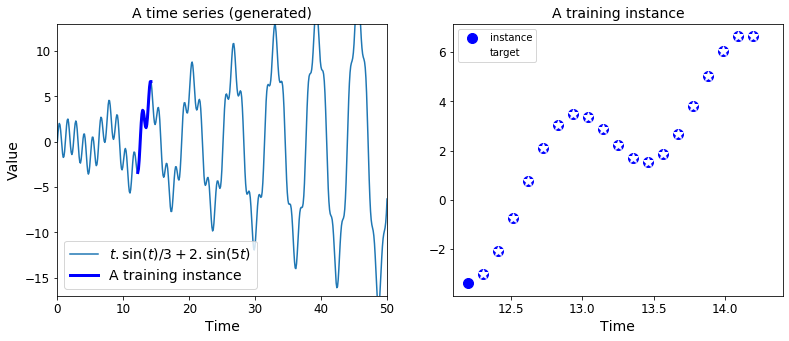

In [17]:
t = np.linspace(t_min, t_max, int((t_max - t_min) / resolution))

n_steps = 20
t_instance = np.linspace(12.2, 12.2 + resolution * (n_steps + 1), n_steps + 1)

plt.figure(figsize=(13,5))
plt.subplot(121)
plt.title("A time series (generated)", fontsize=14)
plt.plot(t, time_series(t), label=r"$t . \sin(t) / 3 + 2 . \sin(5t)$")
plt.plot(t_instance[:-1], time_series(t_instance[:-1]), "b-", linewidth=3, label="A training instance")
plt.legend(loc="lower left", fontsize=14)
plt.axis([0, 50, -17, 13])
plt.xlabel("Time")
plt.ylabel("Value")

plt.subplot(122)
plt.title("A training instance", fontsize=14)
plt.plot(t_instance[:-1], time_series(t_instance[:-1]), "bo", markersize=10, label="instance")
plt.plot(t_instance[1:], time_series(t_instance[1:]), "w*", markersize=10, label="target")
plt.legend(loc="upper left")
plt.xlabel("Time")


plt.show()

In [18]:
t_instance

array([12.2  , 12.305, 12.41 , 12.515, 12.62 , 12.725, 12.83 , 12.935,
       13.04 , 13.145, 13.25 , 13.355, 13.46 , 13.565, 13.67 , 13.775,
       13.88 , 13.985, 14.09 , 14.195, 14.3  ])

Create the batch

In [19]:
X_batch, y_batch = next_batch(1,n_steps)

In [139]:
X_batch

array([[[-2.21961282],
        [-3.0713284 ],
        [-3.52699897],
        [-3.48527199],
        [-2.96297202],
        [-2.09075927],
        [-1.08095639],
        [-0.17542408],
        [ 0.41374971],
        [ 0.55622319],
        [ 0.23531   ],
        [-0.4479896 ],
        [-1.29982318],
        [-2.08110618],
        [-2.5662678 ],
        [-2.59873872],
        [-2.12959345],
        [-1.22988394],
        [-0.07364174],
        [ 1.10429313]]])

In [140]:
np.c_[X_batch[0], y_batch[0]]

array([[-2.21961282, -3.0713284 ],
       [-3.0713284 , -3.52699897],
       [-3.52699897, -3.48527199],
       [-3.48527199, -2.96297202],
       [-2.96297202, -2.09075927],
       [-2.09075927, -1.08095639],
       [-1.08095639, -0.17542408],
       [-0.17542408,  0.41374971],
       [ 0.41374971,  0.55622319],
       [ 0.55622319,  0.23531   ],
       [ 0.23531   , -0.4479896 ],
       [-0.4479896 , -1.29982318],
       [-1.29982318, -2.08110618],
       [-2.08110618, -2.5662678 ],
       [-2.5662678 , -2.59873872],
       [-2.59873872, -2.12959345],
       [-2.12959345, -1.22988394],
       [-1.22988394, -0.07364174],
       [-0.07364174,  1.10429313],
       [ 1.10429313,  2.06529594]])

## Using an output projectionswrapper

Lets create the RNN. It will ocntain 100 recurrent neurons and we will inrol it over 20 time steps since each trianing instance will be 20 inputs longs. Each input will contain only one features (the value at that time). The targets are also sequences of 20 inputs, each containing a single value:

In [141]:
reset_graph()

n_steps = 20
n_inputs = 1
n_neurons = 100
n_outputs = 1

X = tf.placeholder(tf.float32, [None, n_steps,n_inputs])
y = tf.placeholder(tf.float32, [None, n_steps,n_outputs])

cell = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons,activation=tf.nn.relu)
outputs, states = tf.nn.dynamic_rnn(cell, X, dtype=tf.float32)

At each time step we now have an output vecttor of size 100, but what we actually want is a single output value at each time step. The simplest solution is to wrap the cell in an OutPutProjectionWrapper

In [6]:
reset_graph()

n_steps = 20
n_inputs = 1
n_neurons = 100
n_outputs = 1

X = tf.placeholder(tf.float32, [None, n_steps, n_inputs])
y = tf.placeholder(tf.float32, [None, n_steps, n_outputs])

cell = tf.contrib.rnn.OutputProjectionWrapper(
    tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons, activation=tf.nn.relu),
    output_size=n_outputs)

In [154]:
outputs, states = tf.nn.dynamic_rnn(cell, X, dtype=tf.float32)

In [155]:
learning_rate = 0.001

loss = tf.reduce_mean(tf.square(outputs - y)) # MSE
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(loss)

init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [156]:
n_iterations = 1500
batch_size = 50

with tf.Session() as sess:
    init.run()
    for iteration in range(n_iterations):
        X_batch, y_batch = next_batch(batch_size, n_steps)
        sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        if iteration % 100 == 0:
            mse = loss.eval(feed_dict={X: X_batch, y: y_batch})
            print(iteration, "\tMSE:", mse)
    
    saver.save(sess, "./my_time_series_model") # not shown in the book

0 	MSE: 31.324463
100 	MSE: 1.0124097
200 	MSE: 0.3853259
300 	MSE: 0.13212815
400 	MSE: 0.08052663
500 	MSE: 0.06651885
600 	MSE: 0.07612332
700 	MSE: 0.07454526
800 	MSE: 0.06738027
900 	MSE: 0.05343255
1000 	MSE: 0.073231846
1100 	MSE: 0.054025214
1200 	MSE: 0.086258
1300 	MSE: 0.06097459
1400 	MSE: 0.05899215


In [157]:
with tf.Session() as sess:                          # not shown in the book
    saver.restore(sess, "./my_time_series_model")   # not shown

    X_new = time_series(np.array(t_instance[:-1].reshape(-1, n_steps, n_inputs)))
    y_pred = sess.run(outputs, feed_dict={X: X_new})

INFO:tensorflow:Restoring parameters from ./my_time_series_model


In [158]:
y_pred

array([[[-3.544731 ],
        [-2.4817624],
        [-1.0336136],
        [ 0.6685086],
        [ 2.2181194],
        [ 3.2624257],
        [ 3.5499208],
        [ 3.3389578],
        [ 2.8171554],
        [ 2.1808474],
        [ 1.6329758],
        [ 1.4841931],
        [ 1.8725245],
        [ 2.7146714],
        [ 3.8467987],
        [ 5.085464 ],
        [ 6.1131864],
        [ 6.650974 ],
        [ 6.553697 ],
        [ 6.0186257]]], dtype=float32)

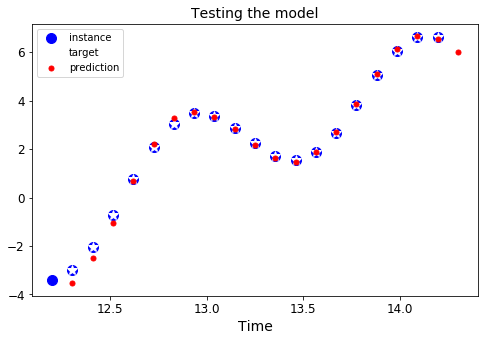

In [159]:
plt.figure(figsize=(8,5))

plt.title("Testing the model", fontsize=14)
plt.plot(t_instance[:-1], time_series(t_instance[:-1]), "bo", markersize=10, label="instance")
plt.plot(t_instance[1:], time_series(t_instance[1:]), "w*", markersize=10, label="target")
plt.plot(t_instance[1:], y_pred[0,:,0], "r.", markersize=10, label="prediction")
plt.legend(loc="upper left")
plt.xlabel("Time")

plt.show()

## Without use an OutputProjectionWrapper

In [10]:
reset_graph()

n_steps = 20
n_inputs = 1
n_neurons = 100

X = tf.placeholder(tf.float32, [None, n_steps,n_inputs])
y = tf.placeholder(tf.float32, [None, n_steps,n_outputs])

In [11]:
cell = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons, activation=tf.nn.relu)
rnn_outputs, states = tf.nn.dynamic_rnn(cell, X,dtype=tf.float32)

In [12]:
n_outputs = 1
learning_rate = 0.001

stacked_rnn_outputs = tf.reshape(rnn_outputs, [-1, n_neurons])
stacked_outputs = tf.layers.dense(stacked_rnn_outputs, n_outputs)
outputs = tf.reshape(stacked_outputs, [-1,n_steps,n_outputs])

Instructions for updating:
Use keras.layers.Dense instead.
Instructions for updating:
Please use `layer.__call__` method instead.


In [13]:
loss = tf.reduce_mean(tf.square(outputs - y))
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(loss)

init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [164]:
n_iterations = 1500
batch_size = 50

with tf.Session() as sess:
    init.run()
    for iteration in range(n_iterations):
        X_batch, y_batch = next_batch(batch_size, n_steps)
        sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        if iteration % 100 == 0:
            mse = loss.eval(feed_dict={X: X_batch, y: y_batch})
            print(iteration, "\tMSE:", mse)
    
    X_new = time_series(np.array(t_instance[:-1].reshape(-1, n_steps, n_inputs)))
    y_pred = sess.run(outputs, feed_dict={X: X_new})
    
    saver.save(sess, "./my_time_series_model_2")

0 	MSE: 36.64575
100 	MSE: 1.0149032
200 	MSE: 0.42222163
300 	MSE: 0.17728256
400 	MSE: 0.08941065
500 	MSE: 0.07549035
600 	MSE: 0.077254154
700 	MSE: 0.08179419
800 	MSE: 0.0693755
900 	MSE: 0.057017192
1000 	MSE: 0.075311705
1100 	MSE: 0.0576041
1200 	MSE: 0.089240715
1300 	MSE: 0.060105424
1400 	MSE: 0.059418436


In [165]:
y_pred

array([[[-3.5787942 ],
        [-2.4721847 ],
        [-1.073645  ],
        [ 0.76658076],
        [ 2.1921294 ],
        [ 3.1595461 ],
        [ 3.5381804 ],
        [ 3.3294528 ],
        [ 2.7989366 ],
        [ 2.167565  ],
        [ 1.609826  ],
        [ 1.5601404 ],
        [ 1.8685616 ],
        [ 2.697559  ],
        [ 3.868255  ],
        [ 5.0797386 ],
        [ 6.048974  ],
        [ 6.6024547 ],
        [ 6.609892  ],
        [ 6.0721297 ]]], dtype=float32)

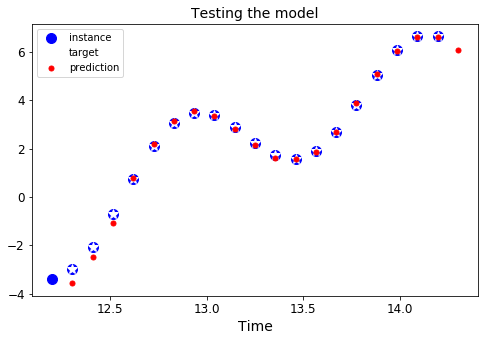

In [167]:
plt.figure(figsize=(8,5))
plt.title("Testing the model", fontsize=14)
plt.plot(t_instance[:-1], time_series(t_instance[:-1]), "bo", markersize=10, label="instance")
plt.plot(t_instance[1:], time_series(t_instance[1:]), "w*", markersize=10, label="target")
plt.plot(t_instance[1:], y_pred[0,:,0], "r.", markersize=10, label="prediction")
plt.legend(loc="upper left")
plt.xlabel("Time")

plt.show()

## Generating a creative new sequence

In [14]:
#call the model back
with tf.Session() as sess:                        # not shown in the book
    saver.restore(sess, "./my_time_series_model_2") # not shown

    sequence = [0.] * n_steps
    for iteration in range(300):
        X_batch = np.array(sequence[-n_steps:]).reshape(1, n_steps, 1)
        y_pred = sess.run(outputs, feed_dict={X: X_batch})
        sequence.append(y_pred[0, -1, 0])

INFO:tensorflow:Restoring parameters from ./my_time_series_model_2


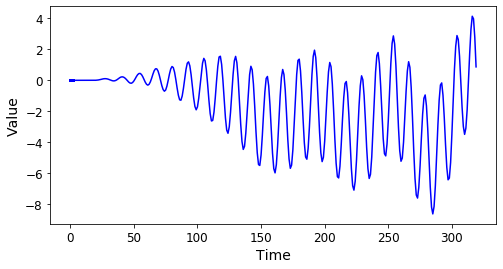

In [20]:
plt.figure(figsize=(8,4))
plt.plot(np.arange(len(sequence)), sequence, "b-")
plt.plot(t[:n_steps], sequence[:n_steps], "b-", linewidth=3)
plt.xlabel("Time")
plt.ylabel("Value")
plt.show()

Create two different sequences of predictions

In [21]:
with tf.Session() as sess:
    saver.restore(sess, "./my_time_series_model_2")
    
    sequence1 = [0. for i in range(n_steps)]
    for iteration in range(len(t) - n_steps):
        X_batch = np.array(sequence[-n_steps:]).reshape(1,n_steps,1)
        y_pred = sess.run(outputs, feed_dict ={X:X_batch})
        sequence1.append(y_pred[0,-1,0])
        
    sequence2 = [time_series(i * resolution + t_min + (t_max-t_min/3)) for i in range(n_steps)]
    for iteration in range(len(t) - n_steps):
        X_batch = np.array(sequence2[-n_steps:]).reshape(1,n_steps,1)
        y_pred = sess.run(outputs, feed_dict= {X: X_batch})
        sequence2.append(y_pred[0,-1,0])

INFO:tensorflow:Restoring parameters from ./my_time_series_model_2


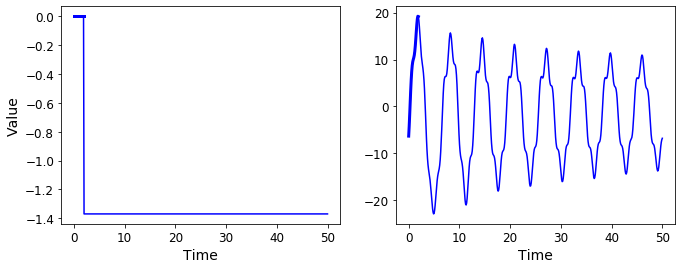

In [22]:
plt.figure(figsize=(11,4))
plt.subplot(121)
plt.plot(t, sequence1, "b-")
plt.plot(t[:n_steps], sequence1[:n_steps], "b-", linewidth=3)
plt.xlabel("Time")
plt.ylabel("Value")

plt.subplot(122)
plt.plot(t, sequence2, "b-")
plt.plot(t[:n_steps], sequence2[:n_steps], "b-", linewidth=3)
plt.xlabel("Time")
plt.show()

## Creating a Deep RNN

MultiRNNCell

In [26]:
reset_graph()

n_inputs = 2
n_steps = 5

X = tf.placeholder(tf.float32, [None, n_steps, n_inputs])

In [27]:
n_neurons = 100
n_layers = 3

layers = [tf.nn.rnn_cell.BasicLSTMCell(num_units=n_neurons)
         for layer in range(n_layers)]

multi_layer_cell = tf.nn.rnn_cell.MultiRNNCell(layers)
outputs, states = tf.nn.dynamic_rnn(multi_layer_cell, X, dtype=tf.float32)

In [28]:
init = tf.global_variables_initializer()

In [29]:
X_batch = np.random.rand(2,n_steps,n_inputs)

In [30]:
with tf.Session() as sess:
    init.run()
    outputs_val, states_val = sess.run([outputs,states],
                                      feed_dict = {X:X_batch})

In [31]:
outputs_val.shape

(2, 5, 100)

In [32]:
outputs_val

array([[[ 5.27355223e-05,  5.90446070e-05, -1.70151252e-04,
         -4.31920125e-05,  1.06879314e-04,  4.61549935e-04,
         -2.14128071e-04,  1.76499365e-04, -3.43163352e-04,
         -2.80370528e-04, -4.59395873e-04,  6.02067506e-04,
         -5.27893601e-04, -3.30663199e-04,  8.32278340e-04,
          7.13179252e-05, -4.25131147e-04,  1.32566478e-04,
          3.64486652e-04,  9.24061285e-04, -6.99719589e-04,
          1.44024903e-04, -1.72660395e-04, -1.86748643e-04,
         -4.54959780e-04,  1.23559148e-04, -1.88670805e-04,
         -9.63236162e-05, -2.18885252e-04,  4.90155770e-04,
          4.12721893e-05, -3.99645069e-04,  7.75908193e-05,
          7.75819120e-04,  4.22404351e-04, -2.35627507e-04,
         -1.04033330e-03, -4.05907660e-04, -3.21730295e-06,
         -2.89889023e-04,  2.89212476e-04,  3.49158247e-04,
         -8.24527160e-05, -5.76865277e-04,  4.78134549e-04,
          5.93537057e-04, -3.47478490e-04,  2.72363366e-04,
         -2.39895991e-04, -2.73917569e-0

In [33]:
print(states_val)
states_val

(LSTMStateTuple(c=array([[-0.03017669, -0.00624169,  0.11546863, -0.00239148, -0.00900369,
        -0.04284344, -0.03834228,  0.04084788,  0.09580249,  0.03894737,
         0.01276434, -0.03160348,  0.05597425, -0.09965092, -0.09914055,
         0.05182017, -0.01092033, -0.04468356,  0.0337467 ,  0.04273634,
        -0.01521264,  0.08823325, -0.0269021 ,  0.06728122,  0.10867285,
        -0.07374759, -0.01049292, -0.11082174, -0.07562767,  0.00281377,
         0.02819695,  0.07166539, -0.06255952,  0.10785668,  0.15055764,
         0.05567117, -0.06972007, -0.03597511, -0.06702894,  0.01080633,
         0.0235565 , -0.08079286, -0.13490254, -0.12033154,  0.0442305 ,
        -0.14358607,  0.15950072,  0.02133698,  0.05138528, -0.03627107,
         0.06476323,  0.02902489,  0.08228213, -0.00436739,  0.01298892,
         0.04688679, -0.10772517,  0.15694742,  0.11971597,  0.07299344,
         0.02169627, -0.05599376, -0.08897746, -0.01933702, -0.06009192,
        -0.07571131, -0.05161848,

(LSTMStateTuple(c=array([[-0.03017669, -0.00624169,  0.11546863, -0.00239148, -0.00900369,
         -0.04284344, -0.03834228,  0.04084788,  0.09580249,  0.03894737,
          0.01276434, -0.03160348,  0.05597425, -0.09965092, -0.09914055,
          0.05182017, -0.01092033, -0.04468356,  0.0337467 ,  0.04273634,
         -0.01521264,  0.08823325, -0.0269021 ,  0.06728122,  0.10867285,
         -0.07374759, -0.01049292, -0.11082174, -0.07562767,  0.00281377,
          0.02819695,  0.07166539, -0.06255952,  0.10785668,  0.15055764,
          0.05567117, -0.06972007, -0.03597511, -0.06702894,  0.01080633,
          0.0235565 , -0.08079286, -0.13490254, -0.12033154,  0.0442305 ,
         -0.14358607,  0.15950072,  0.02133698,  0.05138528, -0.03627107,
          0.06476323,  0.02902489,  0.08228213, -0.00436739,  0.01298892,
          0.04688679, -0.10772517,  0.15694742,  0.11971597,  0.07299344,
          0.02169627, -0.05599376, -0.08897746, -0.01933702, -0.06009192,
         -0.07571131,

## In case you wanted to distribute accorss multiple GPUS

### DO NOT DO THIS

In [ ]:
with tf.device("/gpu:0"):  # BAD! This is ignored.
    layer1 = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons)

with tf.device("/gpu:1"):  # BAD! Ignored again.
    layer2 = tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons)

Use a DevieCellWrapper

In [34]:
import tensorflow as tf

class DeviceCellWrapper(tf.nn.rnn_cell.RNNCell):
  def __init__(self, device, cell):
    self._cell = cell
    self._device = device

  @property
  def state_size(self):
    return self._cell.state_size

  @property
  def output_size(self):
    return self._cell.output_size

  def __call__(self, inputs, state, scope=None):
    with tf.device(self._device):
        return self._cell(inputs, state, scope)

## Applying Dropout

Simply add a dropout layer before or after the RNN as usual, but can also apply a dropout layer in between recurrent layers

In [35]:
reset_graph()

n_inputs = 1
n_neurons = 100
n_layers = 3
n_steps = 20
n_outputs = 1

In [36]:
X = tf.placeholder(tf.float32, [None, n_steps, n_inputs])
y = tf.placeholder(tf.float32, [None, n_steps, n_outputs])

Note: the input_keep_prob parameter can be a placeholder, making it possible to set it to any value you want during training, and to 1.0 during testing

In [37]:
keep_prob = tf.placeholder_with_default(1.0, shape =())
cells = [tf.nn.rnn_cell.BasicRNNCell(num_units=n_neurons)
        for layer in range(n_layers)]
cells_drop = [tf.nn.rnn_cell.DropoutWrapper(cell, 
                input_keep_prob = keep_prob ) for cell in cells]
multi_layer_cell = tf.nn.rnn_cell.MultiRNNCell(cells_drop)
rnn_outputs, states = tf.nn.dynamic_rnn(multi_layer_cell, X, dtype=tf.float32)

In [38]:
learning_rate = 0.01

stacked_rnn_outputs = tf.reshape(rnn_outputs, [-1, n_neurons])
stacked_outputs = tf.layers.dense(stacked_rnn_outputs, n_outputs)
outputs = tf.reshape(stacked_outputs, [-1, n_steps, n_outputs])

loss = tf.reduce_mean(tf.square(outputs - y))
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(loss)

init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [39]:
n_iterations = 1500
batch_size = 50
train_keep_prob = 0.5

with tf.Session() as sess:
    init.run()
    for iteration in range(n_iterations):
        X_batch, y_batch = next_batch(batch_size, n_steps)
        _, mse = sess.run([training_op, loss],
                          feed_dict={X: X_batch, y: y_batch,
                                     keep_prob: train_keep_prob})
        if iteration % 100 == 0:                   # not shown in the book
            print(iteration, "Training MSE:", mse) # not shown
    
    saver.save(sess, "./my_dropout_time_series_model")

0 Training MSE: 38.459194
100 Training MSE: 8.638938
200 Training MSE: 7.55881
300 Training MSE: 7.0976367
400 Training MSE: 7.3766427
500 Training MSE: 7.897822
600 Training MSE: 6.3646164
700 Training MSE: 7.8549247
800 Training MSE: 6.05249
900 Training MSE: 7.6370707
1000 Training MSE: 10.773223
1100 Training MSE: 9.2998495
1200 Training MSE: 8.199806
1300 Training MSE: 7.897209
1400 Training MSE: 8.274392


In [40]:
with tf.Session() as sess:
    saver.restore(sess, "./my_dropout_time_series_model")

    X_new = time_series(np.array(t_instance[:-1].reshape(-1, n_steps, n_inputs)))
    y_pred = sess.run(outputs, feed_dict={X: X_new})

INFO:tensorflow:Restoring parameters from ./my_dropout_time_series_model


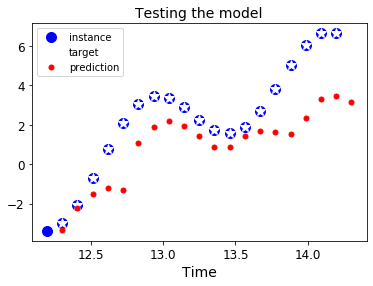

In [41]:
plt.title("Testing the model", fontsize=14)
plt.plot(t_instance[:-1], time_series(t_instance[:-1]), "bo", markersize=10, label="instance")
plt.plot(t_instance[1:], time_series(t_instance[1:]), "w*", markersize=10, label="target")
plt.plot(t_instance[1:], y_pred[0,:,0], "r.", markersize=10, label="prediction")
plt.legend(loc="upper left")
plt.xlabel("Time")

plt.show()

# LSTM

Same as a memeory cell (a bunch of recurrent nuerons) but now has $h_{t}$, which is the short term state and $c_{t}$, which is the long term state.

The network can learn what to keep for the long term state, what to throw away, and what to read in. As the long term state $c_{t-1}$ travers from let to right, it goes through a forget gate, dropping some memories. And it can also add in some new memories which is let in from the input gate. The additional memories can be passed on to next long terms state, or the short term state.

First the current input vector $x$ and the previous short term state $h_{t-1}$ are fed tp 4 different fully connected layers.

The ouput gate $g_{t}$ has its ouputs going to $y_{t}$ and the short term state $h_{t}$

The other three are gate controllers, and use the logistic activation function, so their outputs are from 0 to 1.

The equations are shown below

$
i_{(t)} = \sigma(W_{xi}^T x_{(t)} + W_{hi}^T h_{(t-1)} + b_i) \\
f_{(t)} = \sigma(W_{xf}^T x_{(t)} + W_{hf}^T h_{(t-1)} + b_f) \\
o_{(t)} = \sigma(W_{xo}^T x_{(t)} + W_{ho}^T h_{(t-1)} + b_o) \\
g_{(t)} = tanh(W_{xg}^T x_{(t)} + W_{hg}^T h_{(t-1)} + b_{g}) \\
c_{(t)} = f_{(t)} \otimes c_{(t-1)} + i_{(t)} \otimes g_{(t)} \\
t_{(t)} = h_{(t)} = o_{(t)} \otimes tanh (c_{(t)}) \\
$

So four matrices must be learned from the input vector $x_(t)$ to their the four fully connected layers:  
$
W_{xi}, W_{xf}, W_{xo}, W_{hg}
$

And another four weight matrices that are connected the the previous short term $h_{(t-1)}$:
$
W_{hi}, W_{hf}, W_{ho}, W_{hg}
$

And then biases:
$
b_{i}, b_{f}, b_{o}, b_{g}
$

And $b_f$ is first initialized to 1's

## Implementation

In [52]:
reset_graph()

lstm_cell = tf.nn.rnn_cell.BasicLSTMCell(num_units=n_neurons)

In [54]:
n_steps = 28
n_inputs = 28
n_neurons = 150
n_outputs = 10
n_layers = 3

learning_rate = 0.001

X = tf.placeholder(tf.float32, [None, n_steps,n_inputs])
y = tf.placeholder(tf.int32, [None])

lstm_cells = [tf.nn.rnn_cell.BasicLSTMCell(num_units=n_neurons)
              for layer in range(n_layers)]
multi_cell = tf.nn.rnn_cell.MultiRNNCell(lstm_cells)
outputs, states = tf.nn.dynamic_rnn(multi_cell, X, dtype=tf.float32)
top_layer_h_state = states[-1][1]
logits = tf.layers.dense(top_layer_h_state, n_outputs, name="softmax")
xentropy = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=y, logits=logits)
loss = tf.reduce_mean(xentropy, name="loss")
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(loss)
correct = tf.nn.in_top_k(logits, y, 1)
accuracy = tf.reduce_mean(tf.cast(correct, tf.float32))
    
init = tf.global_variables_initializer()

In [55]:
states

(LSTMStateTuple(c=<tf.Tensor 'rnn_1/while/Exit_3:0' shape=(?, 150) dtype=float32>, h=<tf.Tensor 'rnn_1/while/Exit_4:0' shape=(?, 150) dtype=float32>),
 LSTMStateTuple(c=<tf.Tensor 'rnn_1/while/Exit_5:0' shape=(?, 150) dtype=float32>, h=<tf.Tensor 'rnn_1/while/Exit_6:0' shape=(?, 150) dtype=float32>),
 LSTMStateTuple(c=<tf.Tensor 'rnn_1/while/Exit_7:0' shape=(?, 150) dtype=float32>, h=<tf.Tensor 'rnn_1/while/Exit_8:0' shape=(?, 150) dtype=float32>))

In [56]:
top_layer_h_state

<tf.Tensor 'rnn_1/while/Exit_8:0' shape=(?, 150) dtype=float32>

In [65]:
n_epochs = 5
batch_size = 100

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        for X_batch, y_batch in shuffle_batch(X_train, y_train, batch_size):
            X_batch = X_batch.reshape((-1, n_steps, n_inputs))
            sess.run(training_op, feed_dict={X: X_batch, y: y_batch})
        acc_batch = accuracy.eval(feed_dict={X: X_batch, y: y_batch})
        acc_test = accuracy.eval(feed_dict={X: X_test.reshape((-1, n_steps, n_inputs)), y: y_test})
        print(epoch, "Last batch accuracy:", acc_batch, "Test accuracy:", acc_test)

0 Last batch accuracy: 0.96 Test accuracy: 0.957
1 Last batch accuracy: 0.98 Test accuracy: 0.9736
2 Last batch accuracy: 0.97 Test accuracy: 0.9813
3 Last batch accuracy: 1.0 Test accuracy: 0.9805
4 Last batch accuracy: 1.0 Test accuracy: 0.9794


In [60]:
X_train.reshape((-1, n_steps, n_inputs)).shape

(55000, 28, 28)

In [62]:
X_test.reshape((-1, n_steps, n_inputs)).shape

(10000, 28, 28)

In [64]:
y_test.shape

(10000,)

In [66]:
lstm_cell = tf.nn.rnn_cell.LSTMCell(num_units=n_neurons, use_peepholes=True)


Instructions for updating:
This class is equivalent as tf.keras.layers.LSTMCell, and will be replaced by that in Tensorflow 2.0.


In [67]:
gru_cell = tf.nn.rnn_cell.GRUCell(num_units=n_neurons)

Instructions for updating:
This class is equivalent as tf.keras.layers.GRUCell, and will be replaced by that in Tensorflow 2.0.


## Word2vec tutorial

## Embeddings

In [3]:
from six.moves import urllib
import errno
import os
import zipfile

WORDS_PATH = "datasets/words"
WORDS_URL = 'http://mattmahoney.net/dc/text8.zip'

def mkdir_p(path):
    """Create directories, ok if they already exist.
    
    This is for python 2 support. In python >=3.2, simply use:
    >>> os.makedirs(path, exist_ok=True)
    """
    try:
        os.makedirs(path)
    except OSError as exc:
        if exc.errno == errno.EEXIST and os.path.isdir(path):
            pass
        else:
            raise

def fetch_words_data(words_url=WORDS_URL, words_path=WORDS_PATH):
    os.makedirs(words_path, exist_ok=True)
    zip_path = os.path.join(words_path, "words.zip")
    if not os.path.exists(zip_path):
        urllib.request.urlretrieve(words_url, zip_path)
    with zipfile.ZipFile(zip_path) as f:
        data = f.read(f.namelist()[0])
    return data.decode("ascii").split()

In [4]:
words = fetch_words_data()

In [5]:
len(words)

17005207

In [7]:
words[:13]

['anarchism',
 'originated',
 'as',
 'a',
 'term',
 'of',
 'abuse',
 'first',
 'used',
 'against',
 'early',
 'working',
 'class']

## Build the dictionary

In [14]:
from collections import Counter

vocabulary_size = 50000

vocabulary = [("UNK", None)] + Counter(words).most_common(vocabulary_size - 1)
vocabulary = np.array([word for word, _ in vocabulary])
#encode each word in the vocabulary
#note we could have use sklearn for this, but wanted to remove a dependency
dictionary = {word: code for code, word in enumerate(vocabulary)}
#for each word in words, pull code from dictionary
data = np.array([dictionary.get(word, 0) for word in words])

In [15]:
vocabulary[:5]

array(['UNK', 'the', 'of', 'and', 'one'], dtype='<U28')

In [44]:
words[:5]

['anarchism', 'originated', 'as', 'a', 'term']

In [18]:
data[:5]

array([5234, 3081,   12,    6,  195])

In [124]:
data

array([5234, 3081,   12, ...,   22,   16,   73])

In [75]:
" ".join(words[:10]), data[:10]

('anarchism originated as a term of abuse first used against',
 array([5234, 3081,   12,    6,  195,    2, 3134,   46,   59,  156]))

In [76]:
" ".join([vocabulary[word_index] for word_index in [5241, 3081, 12, 6, 195, 2, 3134, 46, 59]])

'cycles originated as a term of abuse first used'

In [78]:
words[45], data[45]

('violent', 2732)

In [107]:
vocabulary[:20]

array(['UNK', 'the', 'of', 'and', 'one', 'in', 'a', 'to', 'zero', 'nine',
       'two', 'is', 'as', 'eight', 'for', 's', 'five', 'three', 'was',
       'by'], dtype='<U28')

## Generate batches

In [22]:
from collections import deque

def generate_batch(batch_size, num_skips, skip_window):
    #data index must exist
    global data_index
    #check that num_skips goes into batch size
    assert batch_size % num_skips == 0
    #skip window is an upper bound for num_skips
    assert num_skips <= 2 * skip_window
    batch = np.ndarray(shape=[batch_size], dtype=np.int32)
    labels = np.ndarray(shape=[batch_size, 1], dtype=np.int32)
    span = 2 * skip_window + 1 # [ skip_window target skip_window ]
    buffer = deque(maxlen=span)
    for _ in range(span):
        buffer.append(data[data_index])
        data_index = (data_index + 1) % len(data)
    for i in range(batch_size // num_skips):
        target = skip_window  # target label at the center of the buffer
        targets_to_avoid = [ skip_window ]
        for j in range(num_skips):
            while target in targets_to_avoid:
                target = np.random.randint(0, span)
            targets_to_avoid.append(target)
            batch[i * num_skips + j] = buffer[skip_window]
            labels[i * num_skips + j, 0] = buffer[target]
        buffer.append(data[data_index])
        data_index = (data_index + 1) % len(data)
    return batch, labels

In [51]:
data_index = 3
batch_size = 12
num_skips = 2
skip_window = 1
batch = np.ndarray(shape=[batch_size], dtype=np.int32)
labels = np.ndarray(shape=[batch_size, 1], dtype=np.int32)
span = 2 * skip_window + 1 # [ skip_window target skip_window ]
buffer = deque(maxlen=span)
for _ in range(span):
        buffer.append(data[data_index])
        data_index = (data_index + 1) % len(data)

In [53]:
range(span)
    

range(0, 3)

In [60]:
#dont set the seed
data_index = 30
batch, labels = generate_batch(12,2,1)

In [61]:
print(batch)
print(labels)

[195 195  11  11 191 191  59  59   5   5   6   6]
[[    1]
 [   11]
 [  195]
 [  191]
 [   11]
 [   59]
 [    5]
 [  191]
 [   59]
 [    6]
 [10713]
 [    5]]


In [62]:
batch

array([195, 195,  11,  11, 191, 191,  59,  59,   5,   5,   6,   6],
      dtype=int32)

In [63]:
labels

array([[    1],
       [   11],
       [  195],
       [  191],
       [   11],
       [   59],
       [    5],
       [  191],
       [   59],
       [    6],
       [10713],
       [    5]], dtype=int32)

In [64]:
[vocabulary[word] for word in batch]

['term',
 'term',
 'is',
 'is',
 'still',
 'still',
 'used',
 'used',
 'in',
 'in',
 'a',
 'a']

In [152]:
[vocabulary[word] for word in labels[:,0]]

['term', 'as', 'of', 'a', 'abuse', 'term', 'of', 'first', 'used', 'abuse']

In [90]:
labels[:,0]

array([  12, 5234, 3081,    6,  195,   12,    2,    6], dtype=int32)

In [92]:
batch_size = 128
embedding_size = 128 #dimension of the embedding vector
skip_window = 1 #how many words to consider left and right
num_skips = 2 #how many times to reuse an input to generate a label

#we pick a random validation set to sample nearest neighbors,
#here we limit the validation samples to the words thave have a low
#numer ID, which by construction are also the most frequent

valid_size = 16
valid_window = 100
valid_examples = np.random.choice(valid_window, valid_size, replace= False)
num_sampled = 64

learning_rate = 0.01

In [153]:
np.random.choice(20,10)

array([14, 14,  9, 12, 18,  6, 16, 19,  3,  4])

In [93]:
reset_graph()

#input data
train_labels = tf.placeholder(tf.int32, shape = [batch_size,1])
valid_dataset = tf.constant(valid_examples, dtype=tf.int32)

In [94]:
vocabulary_size = 50000
embedding_size = 150

# Look up embeddings for inputs.
init_embeds = tf.random_uniform([vocabulary_size, embedding_size], -1.0, 1.0)
embeddings = tf.Variable(init_embeds)

In [95]:
train_inputs = tf.placeholder(tf.int32, shape=[None])
embed = tf.nn.embedding_lookup(embeddings, train_inputs)

In [96]:
# Construct the variables for the NCE loss
nce_weights = tf.Variable(
    tf.truncated_normal([vocabulary_size, embedding_size],
                        stddev=1.0 / np.sqrt(embedding_size)))
nce_biases = tf.Variable(tf.zeros([vocabulary_size]))

# Compute the average NCE loss for the batch.
# tf.nce_loss automatically draws a new sample of the negative labels each
# time we evaluate the loss.
loss = tf.reduce_mean(
    tf.nn.nce_loss(nce_weights, nce_biases, train_labels, embed,
                   num_sampled, vocabulary_size))

# Construct the Adam optimizer
optimizer = tf.train.AdamOptimizer(learning_rate)
training_op = optimizer.minimize(loss)

# Compute the cosine similarity between minibatch examples and all embeddings.
norm = tf.sqrt(tf.reduce_sum(tf.square(embeddings), axis=1, keepdims=True))
normalized_embeddings = embeddings / norm
valid_embeddings = tf.nn.embedding_lookup(normalized_embeddings, valid_dataset)
similarity = tf.matmul(valid_embeddings, normalized_embeddings, transpose_b=True)

# Add variable initializer.
init = tf.global_variables_initializer()

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


## Train the model


In [154]:

num_steps = 10001

with tf.Session() as session:
    init.run()

    average_loss = 0
    for step in range(num_steps):
        print("\rIteration: {}".format(step), end="\t")
        batch_inputs, batch_labels = generate_batch(batch_size, num_skips, skip_window)
        feed_dict = {train_inputs : batch_inputs, train_labels : batch_labels}
        
        #we peform one update step by evaluating the training op (including it)
        #in the list of returned valeus for session.run()
        _, loss_val = session.run([training_op, loss], feed_dict=feed_dict)
        
        if step % 2000 == 0:
            if step > 0:
                average_loss /= 2000
            #the average loss is an esimtate of the loss over the last 2000 batches
            print('Average loss at step ', step, ":", average_loss)
            #reset to zero
            average_loss = 0
            
        #note that this is expensive (20% slowdown if computed every 500 steps)
        if step % 10000 == 0:
            #get the sim score
            sim = similarity.eval()
            for i in range(valid_size):
                valid_word = vocabulary[valid_examples[i]]
                top_k = 8 #the number of nearest neighbors
                nearest = (-sim[i, :]).argsort()[1:top_k+1]
                log_str = 'Nearest to %s:' % valid_word
                for k in range(top_k):
                    close_word = vocabulary[nearest[k]]
                    log_str = "%s %s," % (log_str, close_word)
                print(log_str)
                
    final_embeddings = normalized_embeddings.eval()

            
            
            
            
            
            
            

Iteration: 0	Average loss at step  0 : 0
Nearest to this: asia, growths, contracting, ammianus, shays, carats, put, soriano,
Nearest to while: ejected, unsound, cheney, zimbabwean, falsely, irr, worrying, forget,
Nearest to so: fermenting, overriding, leaky, alain, broncos, homologous, bateson, arching,
Nearest to and: pierre, savannah, fridays, laminated, reestablish, counters, asymmetric, unchecked,
Nearest to there: glamorgan, ecusa, fenway, families, moko, pumping, useless, convert,
Nearest to their: gaye, parsing, producer, afghana, javier, detrimental, lesbos, kin,
Nearest to was: russo, rammed, investiture, glucagon, heck, adventurer, sharada, homing,
Nearest to seven: northumberland, benchers, clothing, poetic, zone, townes, observational, oppositions,
Nearest to over: tt, tuned, manichaeans, fractional, cambridge, balaguer, fluoride, strenuously,
Nearest to many: spreadsheets, redeemer, nominees, absurd, alerts, xxvi, transylvanian, autonegotiation,
Nearest to in: furnishing, 

THis did not work! Try again later maybe

In [155]:
final_embeddings.shape

(50000, 150)

In [156]:
np.save("./my_final_embeddings.npy", final_embeddings)

## Plot the embeddings

In [158]:
def plot_with_labels(low_dim_embs, labels):
    assert low_dim_embs.shape[0] >= len(labels), "More labels than embeddings"
    plt.figure(figsize=(18, 18))  #in inches
    for i, label in enumerate(labels):
        x, y = low_dim_embs[i,:]
        plt.scatter(x, y)
        plt.annotate(label,
                     xy=(x, y),
                     xytext=(5, 2),
                     textcoords='offset points',
                     ha='right',
                     va='bottom')


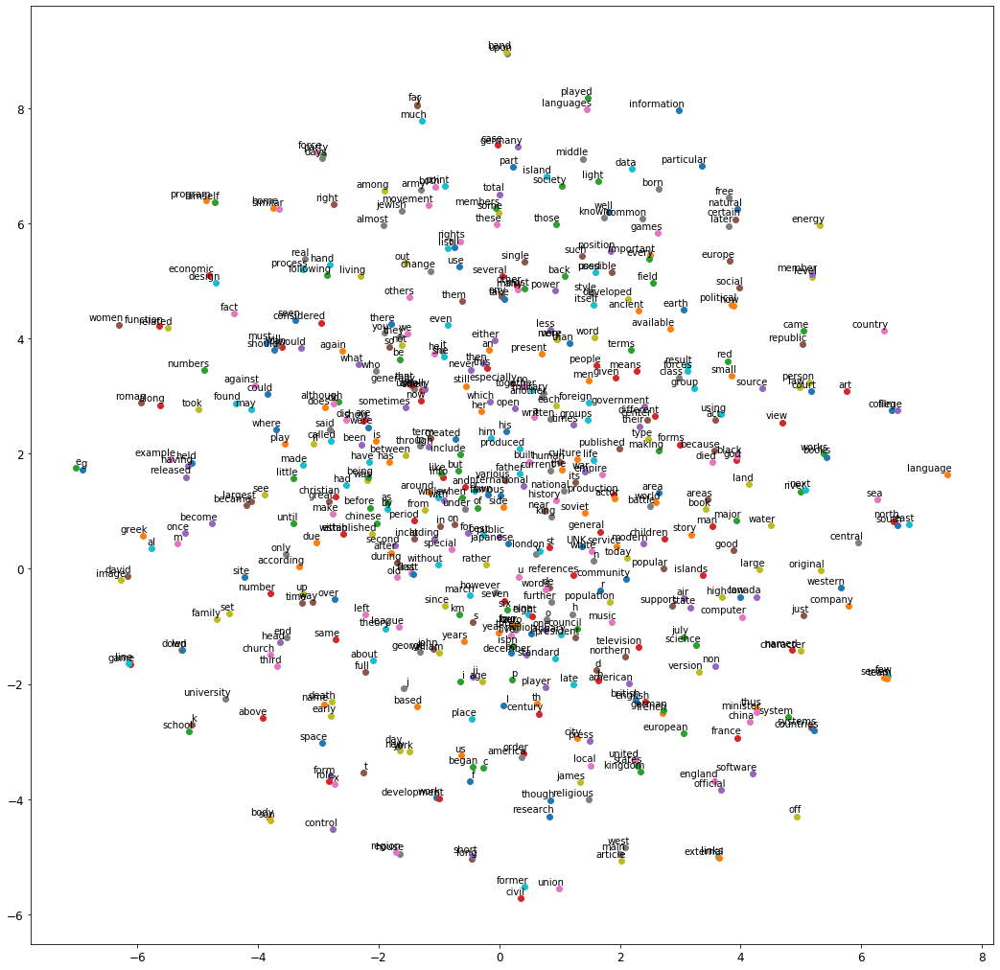

In [159]:
from sklearn.manifold import TSNE

tsne = TSNE(perplexity=30, n_components=2, init='pca', n_iter=5000)
plot_only = 500
low_dim_embs = tsne.fit_transform(final_embeddings[:plot_only,:])
labels = [vocabulary[i] for i in range(plot_only)]
plot_with_labels(low_dim_embs, labels)

## Machine Translation

The basic_rnn_seq2seq() function creates a simple Encoder/Decoder model: it first runs an RNN to encode encoder_inputs into a state vector, then runs a decoder initialized with the last encoder state on decoder_inputs. Encoder and decoder use the same RNN cell type but they don't share parameters.

In [163]:
import tensorflow as tf
reset_graph()

n_steps = 50
n_neurons = 200
n_layers = 3
num_encoder_symbols = 20000
num_decoder_symbols = 20000
embedding_size = 150
learning_rate = 0.01

X = tf.placeholder(tf.int32, [None, n_steps]) #English setences as input
Y = tf.placeholder(tf.int32, [None, n_steps]) #the ouput of tranlated french
W = tf.placeholder(tf.float32, [None, n_steps -1,1])
Y_input = Y[:,:-1]
Y_target = Y[:, 1:]

encoder_inputs = tf.unstack(tf.transpose(X)) #list of 1D tensors
decoder_inputs = tf.unstack(tf.transpose(Y_input)) #list of 1D tensors

lstm_cells = [tf.nn.rnn_cell.BasicLSTMCell(num_units=n_neurons)
              for layer in range(n_layers)]

cell = tf.nn.rnn_cell.MultiRNNCell(lstm_cells)

output_seqs, states = tf.contrib.legacy_seq2seq.embedding_rnn_seq2seq(
    encoder_inputs,
    decoder_inputs,
    cell,
    num_encoder_symbols,
    num_decoder_symbols,
    embedding_size)

logits = tf.transpose(tf.unstack(output_seqs), perm=[1, 0, 2])

logits_flat = tf.reshape(logits, [-1, num_decoder_symbols])
Y_target_flat = tf.reshape(Y_target, [-1])
W_flat = tf.reshape(W, [-1])
xentropy = W_flat * tf.nn.sparse_softmax_cross_entropy_with_logits(labels=Y_target_flat, logits=logits_flat)
loss = tf.reduce_mean(xentropy)
optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
training_op = optimizer.minimize(loss)

init = tf.global_variables_initializer()


Instructions for updating:
Please use `keras.layers.RNN(cell, unroll=True)`, which is equivalent to this API
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


Lets take a look at the graph nodes

In [164]:
show_graph(tf.get_default_graph())

# Exercise: Embedded Reber Grammars

First we need to build a function that generate strings based on a grammar. The grammar will be represented as a list of possible transitions for each state.

In [177]:
default_reber_grammar = [
    [("B", 1)],           # (state 0) =B=>(state 1)
    [("T", 2), ("P", 3)], # (state 1) =T=>(state 2) or =P=>(state 3)
    [("S", 2), ("X", 4)], # (state 2) =S=>(state 2) or =X=>(state 4)
    [("T", 3), ("V", 5)], # and so on...
    [("X", 3), ("S", 6)],
    [("P", 4), ("V", 6)],
    [("E", None)]] 

embedded_reber_grammar = [
    [("B", 1)],
    [("T", 2), ("P", 3)],
    [(default_reber_grammar, 4)],
    [(default_reber_grammar, 5)],
    [("T", 6)],
    [("P", 6)],
    [("E", None)]]

def generate_string(grammar):
    state = 0
    output = []
    while state is not None:
        #identify index, buy radomly starting
        index = np.random.randint(len(grammar[state]))
        #advance and get state
        production, state = grammar[state][index]
        #update production if its in list
        if isinstance(production,list):
            #FUCKING RECURSE!
            production = generate_string(grammar=production)
        output.append(production)
    return("".join(output))

In [198]:
default_reber_grammar[3][0]

('T', 3)

In [191]:
len(default_reber_grammar[0])

1

In [195]:
np.random.randint(3)

1

Let's test the fnction and see if it works well for the default reber grammar

In [187]:
for _ in range(25):
    print(generate_string(default_reber_grammar),end= "  ")

BTSXXTTVVE  BPVVE  BPVPXTTTTTVVE  BTSXXTVPSE  BTXSE  BPTVPXTTVVE  BTSXXVPXVPSE  BTSSXXTTTVVE  BTXXTTVVE  BPVVE  BPVVE  BPTVVE  BPVVE  BPVVE  BPVVE  BTSXSE  BTXXTTTTVPSE  BPTTVPXVVE  BTXXTTVVE  BPVVE  BTSSSXXVPSE  BPTTTTVPXVPXTTTVPXTTTVPSE  BPTTTTVPXTTTTVVE  BTSSXXVPXTTVVE  BTSXSE  

Lets see if this works with the embedded reber

In [182]:
for _ in range(25):
    print(generate_string(embedded_reber_grammar),end= "  ")

BTBTXXVVETE  BPBPVPXVVEPE  BTBTXXVPSETE  BTBPTTVPSETE  BTBPTVPSETE  BTBPVVETE  BTBPTVPSETE  BTBTXXTVPXTVPSETE  BTBTSXXTVPSETE  BPBTXXVVEPE  BTBPVVETE  BPBPTVPSEPE  BTBTXSETE  BPBTXXTTVVEPE  BTBTXXVPSETE  BTBPTVVETE  BTBTXXVPSETE  BPBPVVEPE  BPBTSSXSEPE  BPBPTTVPXVPSEPE  BTBPVVETE  BPBTXSEPE  BPBTXXVPXVPSEPE  BPBPTTVVEPE  BTBPVVETE  

This was respecting the rules and states of reber grammar. We could generate a random string, but the the task would be too easy, so will will create a string that respects the grammar, but augments it in one position.

In [199]:
def generate_corrupted_string(grammar, chars="BEPSTVX"):
    good_string = generate_string(grammar)
    index = np.random.randint(len(good_string))
    good_char = good_string[index]
    bad_char = np.random.choice(sorted(set(chars)-set(good_char)))
    return(good_string[:index] + bad_char + good_string[index + 1:])

Lets generate a few corrupt strings

In [206]:
for _ in range(25):
    print(generate_corrupted_string(embedded_reber_grammar), end=" ")

BPBTXXVPBTTVPSEPE BTBPVVEPE BPBXVPXTTTVVEPE BPBPVPXTTVVEPS BPBPVPSEVE BTBPTTVTETE BTBTSEXVVETE BTBPTVVEPE BTBPVPXTTVPXTTVPSETV BPBTVVEPE BPBPTTVPSVPE BTBPVVEPE BPBTXXTVVEPS BTBXVPXTTVVETE BVBPVVETE BTBPTTVBETE BPVPTVPXTTVVEPE BTBTSXSTTE BTBTSSSXXTVETE BPBPVPXTVVTPE BTBSXSETE BTBTSSSSXTTVVETE BTBEXSETE SPBPTTTVVEPE BPBTSSSSSTXSEPE 

It's not possible to feed a string directly to an RNN: we need to convert it to a sequence of vectors, first. Each vector will represent a single letter, using a one-hot encoding. For example, the letter "B" will be represented as the vector [1, 0, 0, 0, 0, 0, 0], the letter E will be represented as [0, 1, 0, 0, 0, 0, 0] and so on. Let's write a function that converts a string to a sequence of such one-hot vectors. Note that if the string is shorted than n_steps, it will be padded with zero vectors (later, we will tell TensorFlow how long each string actually is using the sequence_length parameter).

In [208]:
def string_to_one_hot_vectors(string, n_steps, chars="BEPSTVX"):
    char_to_index = {char:index for index,char in enumerate(chars)}
    output = np.zeros((n_steps,len(chars)),dtype=np.int32)
    for index,char in enumerate(string):
        output[index,char_to_index[char]] = 1
    return(output)

In [210]:
string_to_one_hot_vectors("BTBTXSETE", 14)

array([[1, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 1, 0, 0],
       [1, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 1, 0, 0],
       [0, 0, 0, 0, 0, 0, 1],
       [0, 0, 0, 1, 0, 0, 0],
       [0, 1, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 1, 0, 0],
       [0, 1, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0]], dtype=int32)

We can now generae the dataset, with 50% good strings, and 50% bad strings

In [217]:
def generate_dataset(size):
    good_strings = [generate_string(embedded_reber_grammar)
                    for _ in range(size // 2)]
    bad_strings = [generate_corrupted_string(embedded_reber_grammar)
                   for _ in range(size - size // 2)]
    all_strings = good_strings + bad_strings
    n_steps = max([len(string) for string in all_strings])
    X = np.array([string_to_one_hot_vectors(string, n_steps)
                  for string in all_strings])
    seq_length = np.array([len(string) for string in all_strings])
    y = np.array([[1] for _ in range(len(good_strings))] +
                 [[0] for _ in range(len(bad_strings))])
    rnd_idx = np.random.permutation(size)
    return X[rnd_idx], seq_length[rnd_idx], y[rnd_idx]


In [218]:
X_train, l_train, y_train = generate_dataset(10000)

In [219]:
X_train.shape

(10000, 38, 7)

In [220]:
l_train.shape

(10000,)

In [224]:
y_train

array([[0],
       [0],
       [1],
       ...,
       [0],
       [1],
       [0]])

In [225]:
X_train[5]

array([[1, 0, 0, 0, 0, 0, 0],
       [0, 0, 1, 0, 0, 0, 0],
       [1, 0, 0, 0, 0, 0, 0],
       [0, 0, 1, 0, 0, 0, 0],
       [0, 0, 0, 0, 1, 0, 0],
       [0, 0, 0, 0, 0, 1, 0],
       [0, 0, 0, 0, 0, 1, 0],
       [0, 1, 0, 0, 0, 0, 0],
       [0, 0, 1, 0, 0, 0, 0],
       [0, 1, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0],
       [0,

In [226]:
max(l_train)

38

What's the class for this string?

In [230]:
y_train[0]

array([0])

We are now ready to create the RNN to identify good strings. We will build a sequence classifier very similar to the one we built earlier to classify MNSIT imags, with two main differences:
* First, the input strings have variable length, so we need to specify the sequence_length() when calling the dynamic_rnn() function
* Second, this is a binary classifier, so we only need one output, that will output for each input string, the estimated log probability that it is a good string.
* For multicall, we use sparse_softmax_cross_entropy_with_logits(), but for binary classification we use sigmoid_cross_entropy_with_logits()

In [231]:
reset_graph()

possible_chars = "BEPSTVX"
n_inputs = len(possible_chars)
n_neurons = 30
n_outputs = 1

learning_rate = 0.02
momentum = 0.95

X = tf.placeholder(tf.float32, [None, None, n_inputs], name="X")
seq_length = tf.placeholder(tf.int32, [None], name="seq_length")
y = tf.placeholder(tf.float32, [None, 1], name="y")

gru_cell = tf.nn.rnn_cell.GRUCell(num_units=n_neurons)
outputs, states = tf.nn.dynamic_rnn(gru_cell, X, dtype=tf.float32,
                                    sequence_length=seq_length)

logits = tf.layers.dense(states, n_outputs, name="logits")
y_pred = tf.cast(tf.greater(logits, 0.), tf.float32, name="y_pred")
y_proba = tf.nn.sigmoid(logits, name="y_proba")

xentropy = tf.nn.sigmoid_cross_entropy_with_logits(labels=y, logits=logits)
loss = tf.reduce_mean(xentropy, name="loss")
optimizer = tf.train.MomentumOptimizer(learning_rate=learning_rate,
                                       momentum=momentum,
                                       use_nesterov=True)
training_op = optimizer.minimize(loss)

correct = tf.equal(y_pred, y, name="correct")
accuracy = tf.reduce_mean(tf.cast(correct, tf.float32), name="accuracy")

init = tf.global_variables_initializer()
saver = tf.train.Saver()

In [232]:
show_graph(tf.get_default_graph())

In [233]:
X_val, l_val, y_val = generate_dataset(5000)

In [234]:
X_val.shape

(5000, 38, 7)

In [235]:
l_val

array([13, 13, 18, ...,  9, 17,  9])

In [237]:
np.unique(y_val,return_counts=True)

(array([0, 1]), array([2500, 2500]))

IT padded with the zeros vectors up to 38, because 38 was the longest string 

In [238]:
n_epochs = 50
batch_size = 50

with tf.Session() as sess:
    init.run()
    for epoch in range(n_epochs):
        X_batches = np.array_split(X_train, len(X_train) // batch_size)
        l_batches = np.array_split(l_train, len(l_train) // batch_size)
        y_batches = np.array_split(y_train, len(y_train) // batch_size)
        for X_batch, l_batch, y_batch in zip(X_batches, l_batches, y_batches):
            loss_val, _ = sess.run(
                [loss, training_op],
                feed_dict={X: X_batch, seq_length: l_batch, y: y_batch})
        acc_train = accuracy.eval(feed_dict={X: X_batch, seq_length: l_batch, y: y_batch})
        acc_val = accuracy.eval(feed_dict={X: X_val, seq_length: l_val, y: y_val})
        print("{:4d}  Train loss: {:.4f}, accuracy: {:.2f}%  Validation accuracy: {:.2f}%".format(
            epoch, loss_val, 100 * acc_train, 100 * acc_val))
        saver.save(sess, "./my_reber_classifier")

   0  Train loss: 0.6844, accuracy: 52.00%  Validation accuracy: 48.96%
   1  Train loss: 0.6780, accuracy: 52.00%  Validation accuracy: 48.50%
   2  Train loss: 0.6685, accuracy: 50.00%  Validation accuracy: 48.96%
   3  Train loss: 0.5307, accuracy: 78.00%  Validation accuracy: 72.44%
   4  Train loss: 0.5244, accuracy: 80.00%  Validation accuracy: 73.66%
   5  Train loss: 0.3927, accuracy: 82.00%  Validation accuracy: 75.58%
   6  Train loss: 0.3575, accuracy: 86.00%  Validation accuracy: 84.94%
   7  Train loss: 0.4646, accuracy: 80.00%  Validation accuracy: 82.28%
   8  Train loss: 0.4860, accuracy: 80.00%  Validation accuracy: 71.96%
   9  Train loss: 0.2061, accuracy: 94.00%  Validation accuracy: 94.50%
  10  Train loss: 0.1101, accuracy: 98.00%  Validation accuracy: 96.72%
  11  Train loss: 0.0147, accuracy: 100.00%  Validation accuracy: 98.06%
  12  Train loss: 0.0168, accuracy: 100.00%  Validation accuracy: 98.08%
  13  Train loss: 0.0138, accuracy: 100.00%  Validation accura

In [239]:
test_strings = [
    "BPBTSSSSSSSXXTTVPXVPXTTTTTVVETE",
    "BPBTSSSSSSSXXTTVPXVPXTTTTTVVEPE"]
l_test = np.array([len(s) for s in test_strings])
max_length = l_test.max()
X_test = [string_to_one_hot_vectors(s, n_steps=max_length)
          for s in test_strings]

with tf.Session() as sess:
    saver.restore(sess, "./my_reber_classifier")
    y_proba_val = y_proba.eval(feed_dict={X: X_test, seq_length: l_test})

print()
print("Estimated probability that these are Reber strings:")
for index, string in enumerate(test_strings):
    print("{}: {:.2f}%".format(string, 100 * y_proba_val[index][0]))

INFO:tensorflow:Restoring parameters from ./my_reber_classifier

Estimated probability that these are Reber strings:
BPBTSSSSSSSXXTTVPXVPXTTTTTVVETE: 0.05%
BPBTSSSSSSSXXTTVPXVPXTTTTTVVEPE: 99.99%


PHEW! That was a lot, I need to take another day to review this

In [174]:
class Foo:
    a =5

In [227]:
type(Foo)

type

In [228]:
Foo

__main__.Foo

In [229]:
Foo.a

5